<a href="https://colab.research.google.com/github/Giorgiodgl/Algorithms_For_Massive_Data/blob/main/AMD_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import files, drive
import os
import shutil
from PIL import Image
import glob
import IPython.display as display
import tensorflow as tf
from tensorflow.keras.utils import image_dataset_from_directory
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, RandomRotation, RandomBrightness, RandomContrast, Conv2D, BatchNormalization, MaxPooling2D, Dropout, Flatten, Dense, Softmax
!pip install keras_tuner
import keras_tuner as kt
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix
import numpy as np

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.1/176.1 kB 4.2 MB/s eta 0:00:00


Loading dataset

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#creating directory kaggle
!mkdir ~/.kaggle/

In [ ]:
#uploading kaggle.json file
!cp /content/drive/MyDrive/kaggle/kaggle.json ~/.kaggle/kaggle.json

In [ ]:
#allocate required permission
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
#downloading project
!kaggle datasets download -d csafrit2/plant-leaves-for-image-classification --force

100% 6.56G/6.56G [01:08<00:00, 75.4MB/s]
100% 6.56G/6.56G [01:08<00:00, 102MB/s] 


In [ ]:
#unzip dataset
!unzip -q /content/plant-leaves-for-image-classification.zip

Deleting diseaded images

In [ ]:
dir = ['/content/Plants_2/train',
       '/content/Plants_2/valid',
       '/content/Plants_2/test']

In [ ]:
for i in dir:
    diseased_img = [x for x in os.listdir(i) if 'diseased' in x]
    for y in diseased_img:
        shutil.rmtree(os.path.join(i, y))

Preprocessing

In [ ]:
def show_and_resize_image(image_path, size_pixels):
    # Open the original image
    original_image = Image.open(image_path)

    # Resize the image
    new_image = original_image.resize((size, size))

    # Display the original image
    display.display(original_image)

    # Display the resized image
    display.display(new_image)


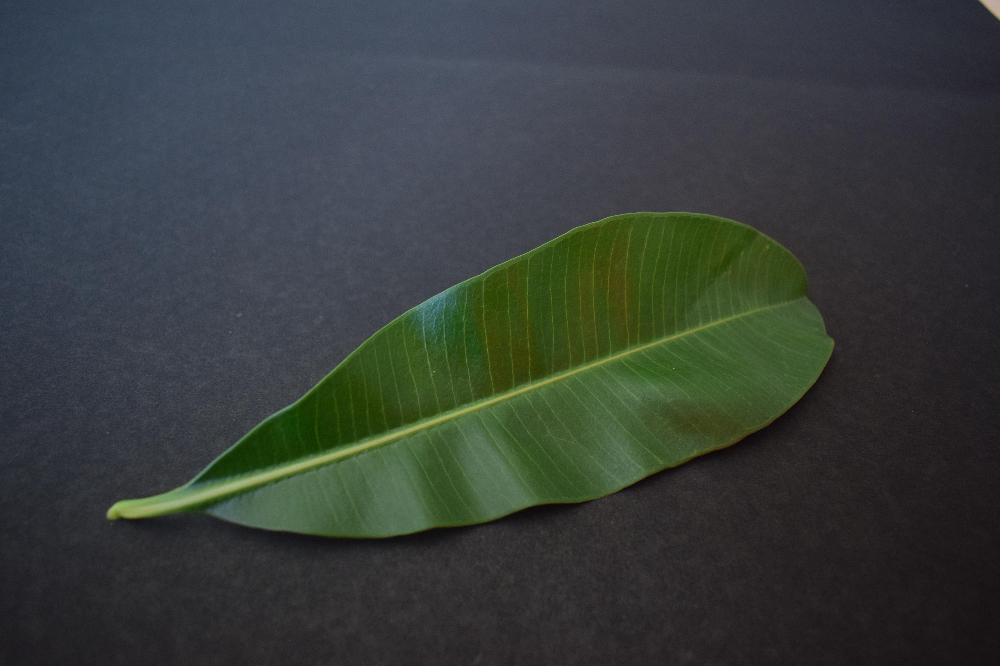

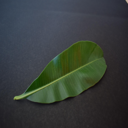

In [ ]:
# Example usage:
# Provide the path to your image file and the desired size
image_path = '/content/Plants_2/train/Alstonia Scholaris healthy (P2b)/0003_0011.JPG'
size = 128

show_and_resize_image(image_path, size)

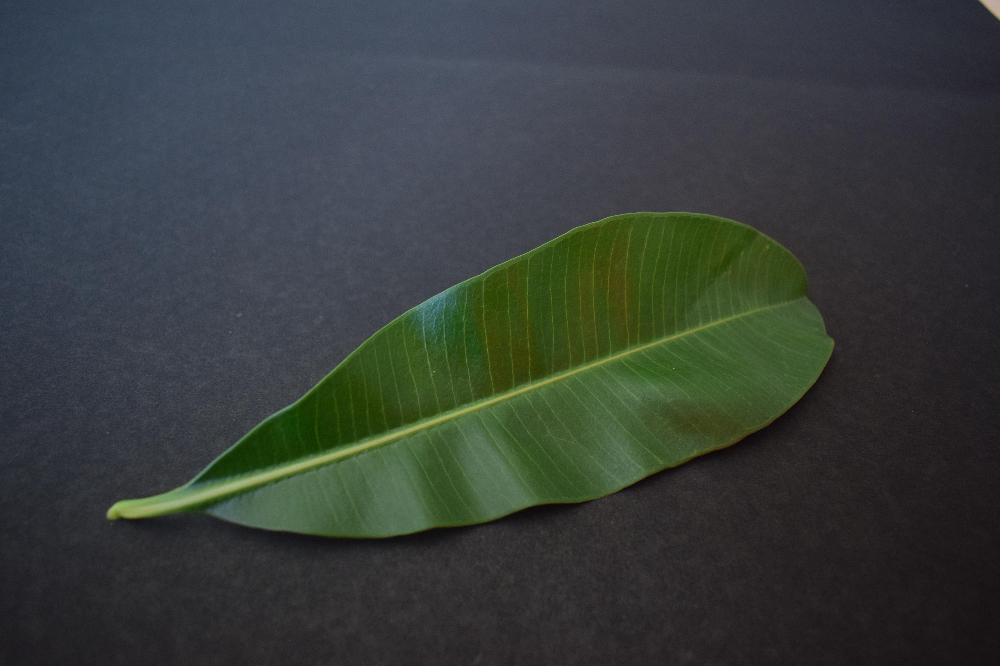

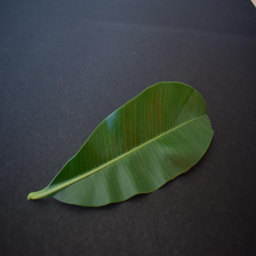

In [ ]:

# Example usage:
# Provide the path to your image file and the desired size
image_path = '/content/Plants_2/train/Alstonia Scholaris healthy (P2b)/0003_0011.JPG'
size = 256

show_and_resize_image(image_path, size)

In [ ]:
for path in dir:
  i = 0
  for img_path in glob.iglob(path + '/*/*.JPG', recursive=True):
        img = Image.open(img_path)
        img_new = img.resize((size, size)) #resample method = BICUBIC (default)
        img_path_new = img_path[:-4] + "_new" + img_path[-4:]
        img_new.save(img_path_new, 'JPEG')
        os.remove(img_path)
        i += 1
        print(i)

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


In [ ]:
!zip -r -q /content/Plants_2.zip /content/Plants_2
shutil.copy("/content/Plants_2.zip","/content/drive/MyDrive/")

'/content/drive/MyDrive/Plants_2.zip'

Model

In [ ]:
train = image_dataset_from_directory(dir[0], image_size=(size, size))
val = image_dataset_from_directory(dir[1], image_size=(size, size))
test = image_dataset_from_directory(dir[2], image_size=(size, size), shuffle = False)

Found 2163 files belonging to 11 classes.
Found 55 files belonging to 11 classes.
Found 55 files belonging to 11 classes.


In [ ]:
def model(hp):
#defining hyperparameters
  learning_rate = hp.Choice('learning_rate', values = [1e-2, 1e-3])

  filter_layer_1 = hp.Choice("filter_layer_1", values = [24,32])
  filter_layer_2 = hp.Choice("filter_layer_2", values = [24,32])
  filter_layer_3 = hp.Choice("filter_layer_3", values = [24,32])

  model=Sequential()
  model.add(Input(shape = (size, size, 3)))
  model.add(RandomRotation(0.2))
  model.add(RandomBrightness(0.2))
  model.add(RandomContrast(0.2))
  model.add(Conv2D(filter_layer_1,kernel_size = (3,3),activation='relu'))
  model.add(BatchNormalization())
  model.add(MaxPooling2D(pool_size=(2,2)))
  model.add(Dropout(0.2, seed = 42))
  model.add(Conv2D(filter_layer_2,kernel_size = (3,3),activation='relu'))
  model.add(BatchNormalization())
  model.add(MaxPooling2D(pool_size=(2,2)))
  model.add(Dropout(0.2, seed = 42))
  model.add(Conv2D(filter_layer_3,kernel_size = (3,3),activation='relu'))
  model.add(BatchNormalization())
  model.add(MaxPooling2D(pool_size=(2,2)))
  model.add(Dropout(0.2, seed = 42))
  model.add(Flatten())
  model.add(Dense(32))
  model.add(Dropout(0.5, seed = 42))
  model.add(Dense(11,activation='softmax'))
  model.compile(loss='sparse_categorical_crossentropy',optimizer='Adam',metrics=['accuracy'])
  return model


In [ ]:
tuner = kt.RandomSearch(model, objective = "val_accuracy", max_trials = 10)
tuner.search(train, validation_data = val, epochs = 10)

Trial 10 Complete [00h 01m 36s]
val_accuracy: 0.800000011920929

Best val_accuracy So Far: 0.800000011920929
Total elapsed time: 00h 15m 19s


In [ ]:
tuner.results_summary()

Results summary
Results in ./untitled_project
Showing 10 best trials
Objective(name="val_accuracy", direction="max")

Trial 09 summary
Hyperparameters:
learning_rate: 0.001
filter_layer_1: 32
filter_layer_2: 24
filter_layer_3: 32
Score: 0.800000011920929

Trial 01 summary
Hyperparameters:
learning_rate: 0.01
filter_layer_1: 32
filter_layer_2: 24
filter_layer_3: 32
Score: 0.7818182110786438

Trial 07 summary
Hyperparameters:
learning_rate: 0.01
filter_layer_1: 32
filter_layer_2: 32
filter_layer_3: 32
Score: 0.7818182110786438

Trial 04 summary
Hyperparameters:
learning_rate: 0.001
filter_layer_1: 24
filter_layer_2: 24
filter_layer_3: 32
Score: 0.7636363506317139

Trial 06 summary
Hyperparameters:
learning_rate: 0.01
filter_layer_1: 24
filter_layer_2: 24
filter_layer_3: 32
Score: 0.7636363506317139

Trial 08 summary
Hyperparameters:
learning_rate: 0.01
filter_layer_1: 24
filter_layer_2: 24
filter_layer_3: 24
Score: 0.7636363506317139

Trial 00 summary
Hyperparameters:
learning_rate: 0.00

In [ ]:
best_hps = tuner.get_best_hyperparameters()[0]
print(best_hps.values)

best_model = tuner.get_best_models()[0]
best_model.summary()

{'learning_rate': 0.001, 'filter_layer_1': 32, 'filter_layer_2': 24, 'filter_layer_3': 32}
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 random_rotation (RandomRota  (None, 256, 256, 3)      0         
 tion)                                                           
                                                                 
 random_brightness (RandomBr  (None, 256, 256, 3)      0         
 ightness)                                                       
                                                                 
 random_contrast (RandomCont  (None, 256, 256, 3)      0         
 rast)                                                           
                                                                 
 conv2d (Conv2D)             (None, 254, 254, 32)      896       
                                                                 
 batch_normalization (BatchN  (

In [ ]:
model.save("amd_cnn_model_day2")
!zip -r -q /content/amd_cnn_model_day2.zip /content/amd_cnn_model_day2
shutil.copy("/content/amd_cnn_model_day2.zip","/content/drive/MyDrive/")

'/content/drive/MyDrive/amd_cnn_model_day2.zip'

In [ ]:
history = best_model.fit(train, validation_data=val, epochs=50)

Epoch 1/50
68/68 [==============================] - 18s 125ms/step - loss: 2.5212 - accuracy: 0.6260 - val_loss: 0.9695 - val_accuracy: 0.8182
Epoch 2/50
68/68 [==============================] - 9s 124ms/step - loss: 2.3519 - accuracy: 0.6551 - val_loss: 1.7138 - val_accuracy: 0.6364
Epoch 3/50
68/68 [==============================] - 8s 121ms/step - loss: 2.0290 - accuracy: 0.6607 - val_loss: 0.6573 - val_accuracy: 0.8000
Epoch 4/50
68/68 [==============================] - 8s 120ms/step - loss: 1.8870 - accuracy: 0.6805 - val_loss: 1.4694 - val_accuracy: 0.7636
Epoch 5/50
68/68 [==============================] - 9s 126ms/step - loss: 1.7879 - accuracy: 0.6852 - val_loss: 0.7053 - val_accuracy: 0.7091
Epoch 6/50
68/68 [==============================] - 9s 125ms/step - loss: 1.5517 - accuracy: 0.7120 - val_loss: 0.5808 - val_accuracy: 0.8727
Epoch 7/50
68/68 [==============================] - 8s 121ms/step - loss: 1.4204 - accuracy: 0.7055 - val_loss: 0.5717 - val_accuracy: 0.9091
Epoch

Results

In [ ]:
results = best_model.evaluate(test)
print("Test Loss: "+str(results[0]))
print("Test Accuracy: " + str(results[1]))

2/2 [==============================] - 0s 25ms/step - loss: 0.1500 - accuracy: 0.9636
Test Loss: 0.15004855394363403
Test Accuracy: 0.9636363387107849


In [ ]:
import matplotlib.pyplot as plt

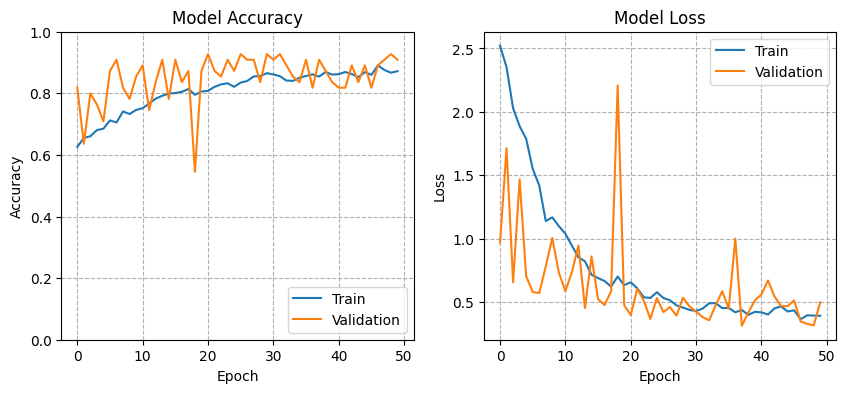

In [ ]:
plt.figure(figsize=(10,4))

plt.subplot(1,2,1)
plt.ylim(0,1)
plt.grid(True, "both", linestyle="--")
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='lower right')

plt.subplot(1,2,2)
plt.grid(True, "both", linestyle="--")
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper right')

plt.show()

2/2 [==============================] - 0s 22ms/step


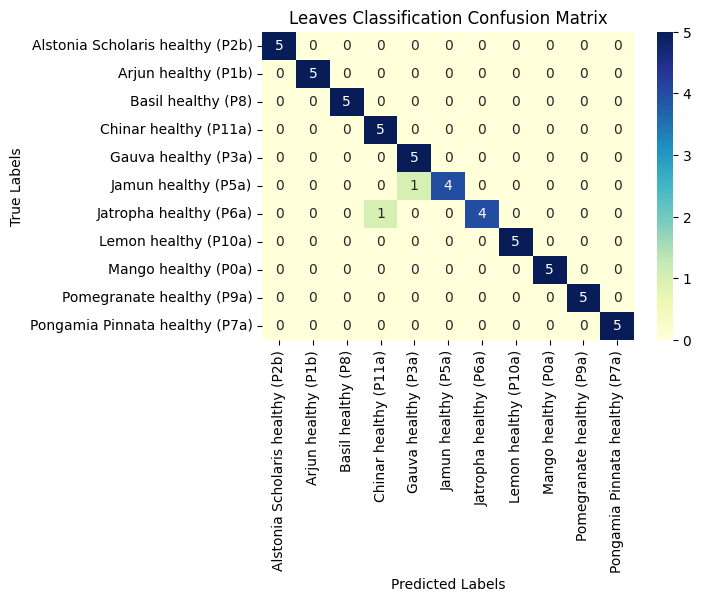

In [ ]:
class_names = train.class_names

# Predict labels using the best model
predicted_labels = np.argmax(best_model.predict(test), axis=1)

# Get true labels and convert label indices to class names
true_labels = np.concatenate([y for x, y in test], axis=0)
true_labels = [class_names[label_int] for label_int in true_labels]
predicted_labels = [class_names[label_int] for label_int in predicted_labels]

# Create a confusion matrix
confusion_mat = confusion_matrix(true_labels, predicted_labels)

# Create a heatmap
plt.figure(figsize=(6, 4))
heatmap = sns.heatmap(confusion_mat,
                      xticklabels=class_names, yticklabels=class_names,
                      annot=True, fmt="d", cmap="YlGnBu")

# Set labels and title
heatmap.set_ylabel("True Labels")
heatmap.set_xlabel("Predicted Labels")
heatmap.set_title("Leaves Classification Confusion Matrix")

# Show the heatmap
plt.show()